<a href="https://colab.research.google.com/github/Fairooz14/Awesome-LLM/blob/main/plant_disease_detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# Installing the packages we need
!pip install tensorflow
!pip install keras
!pip install Pillow
!pip install plotly

In [314]:
# Importing the required libraries
import numpy as np
from concurrent.futures import ThreadPoolExecutor
from PIL import Image
import plotly.graph_objects as go
import plotly.subplots as sp
from IPython import get_ipython
from IPython.display import display
from plotly.subplots import make_subplots
from collections import defaultdict
import random
# Define dataset directories correctly
import os

In [315]:
# Importing Keras
from keras.models import Sequential                          # Neural network model as a sequence of layers.
from keras.layers import Conv2D                              # Convolutional layer
from keras.layers import MaxPooling2D                        # Max pooling layer
from keras.layers import Flatten                             # Layer used to flatten 2D arrays for fully-connected layers.
from keras.layers import Dense                               # This layer adds fully-connected layers to the neural network.
from keras.layers import Dropout                             # This serves to prevent overfitting by dropping out a random set of activations.
from keras.layers import BatchNormalization                  # This is used to normalize the activations of the neurons.
from keras.layers import Activation                          # Layer for activation functions
from keras.callbacks import EarlyStopping, ModelCheckpoint   # Classes used to save weights and stop training when improvements reach a limit
from keras.models import load_model                          # This helps us to load trained models
# Preprocessing layers
from keras.layers import Rescaling                           # This layer rescales pixel values

# Importing TensorFlow
import tensorflow as tf
import os

In [287]:
# Configuring notebook
seed = 123
paper_color = '#EEF6FF'
bg_color = '#EEF6FF'
#colormap =
#template =

In [316]:
def image_resizer(paths):
    """
    This function resizes the input images
    """
    with ThreadPoolExecutor() as executor:
        resized_images = list(executor.map(lambda x: Image.open(x).resize((350,250)), paths))
    return resized_images

def plot_images_list(images, title, subtitle):
    '''
    This functions helps to plot a matrix of images in a list
    '''
    fig = sp.make_subplots(rows=3, cols=3)
    images = image_resizer(images)

    traces = []
    for i in range(min(9, len(images))):
        img = go.Image(z=images[i])
        traces.append((img, i//3+1, i%3+1))

    fig.add_traces([trace[0] for trace in traces],
                  rows = [trace[1] for trace in traces],
                  cols = [trace[2] for trace in traces])

    fig.update_layout(
        title={'text': f'<b>{title}<br>  <i><sub>{subtitle}</sub></i></b>',
               'font': dict(size = 22)},
        height=800,
        width=800,
        margin=dict(t=110, l=80),
        plot_bgcolor=bg_color,paper_bgcolor=paper_color
        #template=template
    )
    fig.show()

In [317]:
# Configuring GPU
gpus = tf.config.experimental.list_physical_devices('GPU')
if gpus:
    try:
        for gpu in gpus:
            tf.config.experimental.set_memory_growth(gpu, True)
        tf.config.experimental.set_visible_devices(gpus[0], 'GPU')
        strategy = tf.distribute.OneDeviceStrategy(device="/gpu:0")
        print('\nGPU Found! Using GPU...')
    except RuntimeError as e:
        print(e)
else:
    strategy = tf.distribute.get_strategy()
    print('Number of replicas:', strategy.num_replicas_in_sync)

Number of replicas: 1


# **Loading and Exploring Dataset**

In [ ]:
!pip install kaggle

In [ ]:
os.environ['KAGGLE_USERNAME'] ='fairooz14'
os.environ['KAGGLE_KEY'] = 'F@ir-002'

In [ ]:
!kaggle datasets download -d rashikrahmanpritom/plant-disease-recognition-dataset

Dataset URL: https://www.kaggle.com/datasets/rashikrahmanpritom/plant-disease-recognition-dataset
License(s): CC0-1.0
plant-disease-recognition-dataset.zip: Skipping, found more recently modified local copy (use --force to force download)


In [ ]:
# !unzip plant-disease-recognition-dataset.zip

Archive:  plant-disease-recognition-dataset.zip
replace Test/Test/Healthy/8ddaa5a5caa5caa8.jpg? [y]es, [n]o, [A]ll, [N]one, [r]ename: 

In [318]:

# Define dataset directories correctly
train_dir = '/content/Train/Train'
test_dir = '/content/Test/Test'
val_dir = '/content/Validation/Validation'

dataset_path = '/content'

train_dir = os.path.join(dataset_path, 'Train')
test_dir = os.path.join(dataset_path, 'Test')
val_dir = os.path.join(dataset_path, 'Validation')

In [319]:
import os

train_dir = '/content/Train/Train'
test_dir = '/content/Test/Test'
val_dir = '/content/Validation/Validation'

# Check if the folders exist
for dir_path in [train_dir, test_dir, val_dir]:
    if os.path.exists(dir_path):
        print(f"Found: {dir_path}")
    else:
        print(f"Not Found: {dir_path}")

Found: /content/Train/Train
Found: /content/Test/Test
Found: /content/Validation/Validation


In [320]:
# Giving names to each directory
directories = {
    os.path.join(train_dir): 'Train',
    os.path.join(test_dir): 'Test',
    os.path.join(val_dir): 'Validation'
}

# Naming subfolders (assuming these are your class names)
subfolders = ['Healthy', 'Powdery', 'Rust']

# Display number of files in each subfolder
print('\n* * * * * Number of files in each folder * * * * *\n')

# Count files in each folder
for dir, name in directories.items():
    total = 0
    if not os.path.exists(dir):
        print(f"\n❌ {name} directory not found!")
        continue
    for sub in subfolders:
        path = os.path.join(dir, sub)
        if not os.path.exists(path):
            print(f"\n⚠️ {name}/{sub} folder not found!")
            continue
        num_files = sum(1 for f in os.listdir(path) if os.path.isfile(os.path.join(path, f)))
        total += num_files
        print(f'\n{name}/{sub}: {num_files} files')
    print(f'\n  Total in {name}: {total} files')
    print("-" * 80)


* * * * * Number of files in each folder * * * * *


Train/Healthy: 458 files

Train/Powdery: 430 files

Train/Rust: 434 files

  Total in Train: 1322 files
--------------------------------------------------------------------------------

Test/Healthy: 50 files

Test/Powdery: 50 files

Test/Rust: 50 files

  Total in Test: 150 files
--------------------------------------------------------------------------------

Validation/Healthy: 20 files

Validation/Powdery: 20 files

Validation/Rust: 20 files

  Total in Validation: 60 files
--------------------------------------------------------------------------------


Convolutional Neural Networks require a fixed size for all images we feed into it. This means that every single image in our dataset must be equally sized, either  128
×
128,  224
×
224
 , and so on.

### **Image Dimension Check**

In [321]:
unique_dimensions = set()

for dir, name in directories.items():
    for sub in subfolders:
        folder_path = os.path.join(dir, sub)

        for file in os.listdir(folder_path):
            image_path = os.path.join(folder_path, file)
            with Image.open(image_path) as img:
                unique_dimensions.add(img.size)

if len(unique_dimensions) == 1:
    print(f"\nAll images have the same dimensions: {unique_dimensions.pop()}")
else:
    print(f"\nFound {len(unique_dimensions)} unique image dimensions: {unique_dimensions}")


Found 8 unique image dimensions: {(4032, 3024), (4000, 2672), (4000, 3000), (5184, 3456), (2592, 1728), (3901, 2607), (4608, 3456), (2421, 2279)}


We have 8 different dimensions across the dataset. In the next cell, I am going to check the distribution of these dimensions across the data.

In [322]:
# Checking if all the images in the dataset have the same dimensions
dims_counts = defaultdict(int)

for dir, name in directories.items():
    for sub in subfolders:
        folder_path = os.path.join(dir, sub)

        for file in os.listdir(folder_path):
            image_path = os.path.join(folder_path, file)
            with Image.open(image_path) as img:
                dims_counts[img.size] += 1

for dimension, count in dims_counts.items():
    print(f"\nDimension {dimension}: {count} images")


Dimension (4000, 2672): 1130 images

Dimension (4000, 3000): 88 images

Dimension (2421, 2279): 1 images

Dimension (2592, 1728): 127 images

Dimension (5184, 3456): 97 images

Dimension (4608, 3456): 72 images

Dimension (4032, 3024): 16 images

Dimension (3901, 2607): 1 images


It seems that most images have dimensions of  4000
×
2672
 , which is a rectangular shape. We can conclude that, due to the differences in dimensions, we will need to apply some preprocessing to the data.

First, we are going to resize the images, so they all have the same shape. Then, we will transform the input from rectangular shape to square shape.

Another crucial consideration is verifying the pixel valye range of the images. In this case, all images should have pixel values spanning from 0 to 255. This consistency simplifies the preprocessing step, since we often normalize pixel values in images to a range going from 0 to 1.

In [323]:
# Checking images dtype
all_uint8 = True
all_in_range = True

for dir, name in directories.items():
    for sub in subfolders:
        folder_path = os.path.join(dir, sub)

        for file in os.listdir(folder_path):
            image_path = os.path.join(folder_path, file)
            with Image.open(image_path) as img:
                img_array = np.array(img)

            if img_array.dtype == 'uint8':
                all_uint8 = False

            if img_array.min() < 0 or img_array.max() > 255:
                all_in_range = False

if all_uint8:
    print(" - All images are of data type uint8\n")
else:
    print(" - Not all images are of data type uint8\n")

if all_in_range:
    print(" - All images have pixel values ranging from 0 to 255")
else:
    print(" - Not all images have the same pixel values from 0 to 255")

 - Not all images are of data type uint8

 - All images have pixel values ranging from 0 to 255


In [324]:
# Loading the directory for each class in the training dataset
train_healthy_dir = train_dir + "/" + 'Healthy'
train_rust_dir = train_dir + "/" + 'Rust'
train_powdery_dir = train_dir + "/" + 'Powdery'

# Selecting 9 random pictures from each directory
healthy_files = random.sample(os.listdir(train_healthy_dir), 9)
rust_files = random.sample(os.listdir(train_rust_dir), 9)
powdery_files = random.sample(os.listdir(train_powdery_dir), 9)

# Plotting healthy plants
healthy_images = [os.path.join(train_healthy_dir, f) for f in healthy_files]
plot_images_list(healthy_images, "Healthy Plants", "Training Dataset")

In [325]:
# Plotting rust plants
rust_images = [os.path.join(train_rust_dir, f) for f in rust_files]
plot_images_list(rust_images, "Rust Plants", "Training Dataset")

In [326]:
# Plotting powdery plants
powdery_images = [os.path.join(train_powdery_dir, f) for f in powdery_files]
plot_images_list(powdery_images, "Powdery Plants", "Training Dataset")


# **Data Preprocessing**

In [327]:
# Creating a Dataset for the Training data
train = tf.keras.utils.image_dataset_from_directory(
    train_dir,  # Directory where the Training images are located
    labels = 'inferred', # Classes will be inferred according to the structure of the directory
    label_mode = 'categorical',
    class_names = ['Healthy', 'Powdery', 'Rust'],
    batch_size = 16,    # Number of processed samples before updating the model's weights
    image_size = (256, 256), # Defining a fixed dimension for all images
    shuffle = True,  # Shuffling data
    seed = seed,  # Random seed for shuffling and transformations
    validation_split = 0, # We don't need to create a validation set from the training set
    crop_to_aspect_ratio = True # Resize images without aspect ratio distortion
)

Found 1322 files belonging to 3 classes.


In [328]:
# Creating a dataset for the Test data
test = tf.keras.utils.image_dataset_from_directory(
    test_dir,
    labels = 'inferred',
    label_mode = 'categorical',
    class_names = ['Healthy', 'Powdery', 'Rust'],
    batch_size = 16,
    image_size = (256, 256),
    shuffle = True,
    seed = seed,
    validation_split = 0,
    crop_to_aspect_ratio = True
)

Found 150 files belonging to 3 classes.


In [329]:
# Creating a dataset for the Test data
validation = tf.keras.utils.image_dataset_from_directory(
    val_dir,
    labels = 'inferred',
    label_mode = 'categorical',
    class_names = ['Healthy', 'Powdery', 'Rust'],
    batch_size = 16,
    image_size = (256, 256),
    shuffle = True,
    seed = seed,
    validation_split = 0,
    crop_to_aspect_ratio = True
)

Found 60 files belonging to 3 classes.


In [330]:
print('\nTraining Dataset:', train)
print('\nTesting Dataset:', test)
print('\nValidation Dataset:', validation)


Training Dataset: <_PrefetchDataset element_spec=(TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 3), dtype=tf.float32, name=None))>

Testing Dataset: <_PrefetchDataset element_spec=(TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 3), dtype=tf.float32, name=None))>

Validation Dataset: <_PrefetchDataset element_spec=(TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 3), dtype=tf.float32, name=None))>




*   _BatchDataset: It indicates that the dataset returns data in batches.
*   element_spec: This describes the structure of the elements in the dataset.


*    TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name = None): This represents the features, in this case the images, in the dataset. None represents the batch size, which is None here because it can vary depending on how many samples we have in the last batch; 256, 256 represents the height and width of the images; 3 is the number of channels in the images, indicating they are RGB images. Last, dtype=tf.float32 tells us that the data type of the image pixels is a 32-bit floating point.
*   TensorSpec(shape=(None, 3), dtype=tf.float32, name=None): This represents the labels/targets of our dataset. Here, None refers to the batch size; 3 refers to the number of labels in the dataset; whilst dtype=tf.float32 is also a 32-bit floating point.





In [331]:
# Checking minimum and maximum pixel values in the Validation dataset
min_value = float('inf')
max_value = -float('inf')

for img, label in validation:
    batch_min = tf.reduce_min(img)
    batch_max = tf.reduce_max(img)

    min_value = min(min_value, batch_min.numpy())
    max_value = max(max_value, batch_max.numpy())

print('\nMinimum pixel value in the Validation dataset', min_value)
print('\nMaximum pixel value in the Validation dataset', max_value)


Minimum pixel value in the Validation dataset 0.0

Maximum pixel value in the Validation dataset 255.0


To bring the pixel values to the 0 to 1 range, we can easily use one of Keras' preprocessing layers

In [332]:
scaler = Rescaling(1./255) # Defining scaler values between 0 to 1

In [333]:
# Rescaling datasets
train = train.map(lambda x, y: (scaler(x), y))
test = test.map(lambda x, y: (scaler(x), y))
validation = validation.map(lambda x, y: (scaler(x), y))

In [334]:
# Checking minimum and maximum pixel values in the Validation dataset
min_value = float('inf')
max_value = -float('inf')

for img, label in validation:
    batch_min = tf.reduce_min(img)
    batch_max = tf.reduce_max(img)

    min_value = min(min_value, batch_min.numpy())
    max_value = max(max_value, batch_max.numpy())

print('\nMinimum pixel value in the Validation dataset', min_value)
print('\nMaximum pixel value in the Validation dataset', max_value)


Minimum pixel value in the Validation dataset 0.0

Maximum pixel value in the Validation dataset 1.0



# **Data Augmentation**

In [335]:
# Creating data augmentation pipeline
augmentation = tf.keras.Sequential(
    [
        tf.keras.layers.RandomRotation(
        factor = (-.25, .3),
        fill_mode = 'reflect',
        interpolation = 'bilinear',
        seed = seed),


        tf.keras.layers.RandomBrightness(
        factor = (-.45, .45),
        value_range = (0.0, 1.0),
        seed = seed),

        tf.keras.layers.RandomContrast(
        factor = (.5),
        seed = seed)
    ]
)

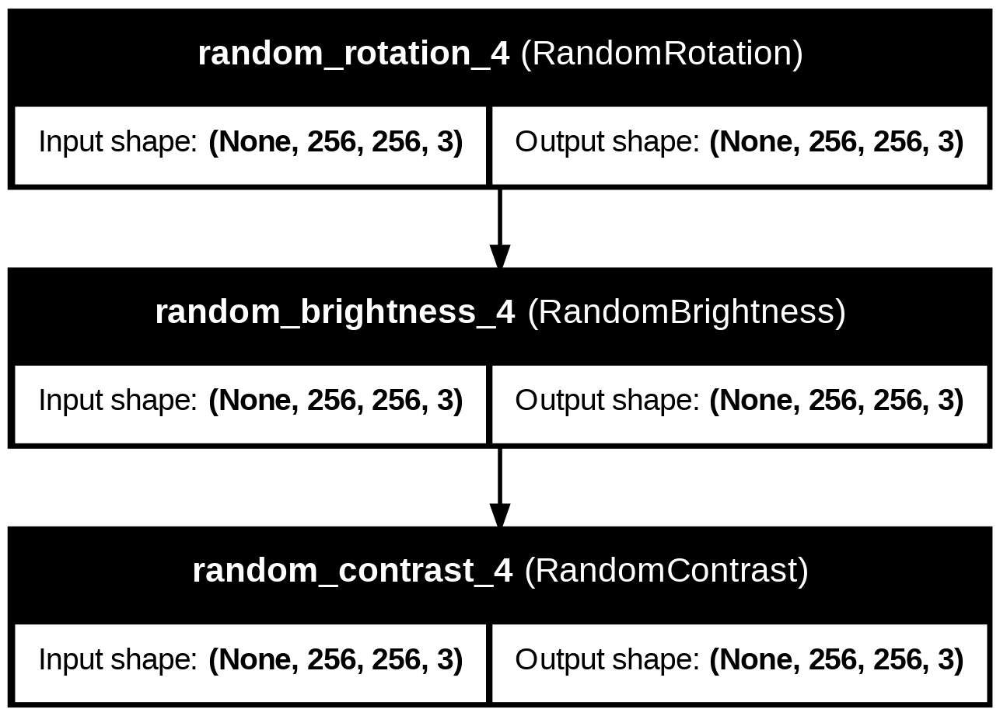

In [336]:
augmentation.build((None, 256, 256, 3)) # Building model
# Plotting model
tf.keras.utils.plot_model(augmentation,
                          show_shapes = True,
                          show_layer_names = True,
                          expand_nested = True)

We are going to attach this data augmentation pipeline to our convolutional neural network. It is important to remember that the data augmentation pipeline is inactive during testing, and the input samples will only be augmented during fit(), not when calling predict().

# **Building the Convolutional Neural Network**



*   BatchNormalization: This layer applies a transformation that maintains the mean output close to  0 and the standard deviation close to  1. It normalizes its inputs and is important to help convergence and generalization.
*   Dropout: This layer randomly sets a fraction of input units to 0 during training, which helps to prevent overfitting.


*   Flatten: This layer transforms a multi-dimensional tensor into a one-dimensional tensor. It is used when transitioning from the Feature Learning segment — Convolutional and Pooling layers — to the fully-connected layers.
*   Kernel used : both  3
×
3 and  5
×
5





In [337]:
# Initiating model on GPU
with strategy.scope():
    model = Sequential()

    model.add(augmentation) # Adding data augmentation pipeline to the model

    # Feature Learning Layers
    model.add(Conv2D(32,                  # Number of filters/Kernels
                     (3,3),               # Size of kernels (3x3 matrix)
                     strides = 1,         # Step size for sliding the kernel across the input (1 pixel at a time).
                     padding = 'same',    # 'Same' ensures that the output feature map has the same dimensions as the input by padding zeros around the input.
                    input_shape = (256,256,3) # Input image shape
                    ))
    model.add(Activation('relu'))# Activation function
    model.add(BatchNormalization())
    model.add(MaxPooling2D(pool_size = (2,2), padding = 'same'))
    model.add(Dropout(0.2))

    model.add(Conv2D(64, (5,5), padding = 'same'))
    model.add(Activation('relu'))
    model.add(BatchNormalization())
    model.add(MaxPooling2D(pool_size = (2,2), padding = 'same'))
    model.add(Dropout(0.2))

    model.add(Conv2D(128, (3,3), padding = 'same'))
    model.add(Activation('relu'))
    model.add(BatchNormalization())
    model.add(MaxPooling2D(pool_size = (2,2), padding = 'same'))
    model.add(Dropout(0.3))

    model.add(Conv2D(256, (5,5), padding = 'same'))
    model.add(Activation('relu'))
    model.add(BatchNormalization())
    model.add(MaxPooling2D(pool_size = (2,2), padding = 'same'))
    model.add(Dropout(0.3))

    model.add(Conv2D(512, (3,3), padding = 'same'))
    model.add(Activation('relu'))
    model.add(BatchNormalization())
    model.add(MaxPooling2D(pool_size = (2,2), padding = 'same'))
    model.add(Dropout(0.3))

    # Flattening tensors
    model.add(Flatten())

    # Fully-Connected Layers
    model.add(Dense(2048))
    model.add(Activation('relu'))
    model.add(Dropout(0.5))

    # Output Layer
    model.add(Dense(3, activation = 'softmax')) # Classification layer

/usr/local/lib/python3.11/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



# **Training  and Testing**



*   optimizer: In this parameter, we define the algorithms to adjust the weight updates. This is an important parameter, because choosing the right optimizer is essential to speed convergence. We are going to use RMSprop
*   loss: This is the loss function we're trying to minimize during training. In this case, we are using categorical_crossentropy, which is a good choice for classification tasks with over two classes.


*    metrics: This parameter defines the metric that will be used to evaluate performance during training and validation. Since our data is not heavily unbalanced, we may use accuracy for this, which is a very straightforward metric given by the following formula:

 `Accuracy = Number of Correct Predictions/Total Number of Predictions`






In [338]:
# Compiling model
model.compile(optimizer = tf.keras.optimizers.RMSprop(0.0001), # 1e-4
              loss = 'categorical_crossentropy', # Ideal for multiclass tasks
              metrics = ['accuracy']) # Evaluation metric

In [339]:
# Defining an Early Stopping and Model Checkpoints
early_stopping = EarlyStopping(monitor = 'val_accuracy',
                              patience = 5, mode = 'max',
                              restore_best_weights = True)

checkpoint = ModelCheckpoint('best_model.h5',
                            monitor = 'val_accuracy',
                            save_best_only = True)

In [340]:
print(f"Total training batches: {len(train)}")
print(f"Total validation batches: {len(test)}")


Total training batches: 83
Total validation batches: 10


In [341]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

datagen = ImageDataGenerator(validation_split=0.2)

train = datagen.flow_from_directory(
    '/content/Train/Train',
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical',
    subset='training'
)

test = datagen.flow_from_directory(
    '/content/Train/Train',
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical',
    subset='validation'
)

print("Train and test generators created successfully!")


Found 1059 images belonging to 3 classes.
Found 263 images belonging to 3 classes.
Train and test generators created successfully!


In [342]:
print(type(train))
print(type(test))

<class 'keras.src.legacy.preprocessing.image.DirectoryIterator'>
<class 'keras.src.legacy.preprocessing.image.DirectoryIterator'>


In [344]:
import cv2
import os

train_path = '/content/Train/Train'

for class_name in os.listdir(train_path):
    class_path = os.path.join(train_path, class_name)
    if os.path.isdir(class_path):
        for img_name in os.listdir(class_path):
            img_path = os.path.join(class_path, img_name)
            try:
                img = cv2.imread(img_path)
                if img is None:
                    print(f"Corrupt Image: {img_path}")
            except Exception as e:
                print(f"Error loading image {img_path}: {e}")


In [345]:
train = datagen.flow_from_directory(
    '/content/Train/Train',
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical',
    subset='training',
    shuffle=True  # Ensure data is shuffled every epoch
)

test = datagen.flow_from_directory(
    '/content/Train/Train',
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical',
    subset='validation',
    shuffle=True
)


Found 1059 images belonging to 3 classes.
Found 263 images belonging to 3 classes.


In [346]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import tensorflow as tf


from tensorflow.keras import Model
from tensorflow.keras.layers import Flatten, Dense

# Find the correct input shape
for layer in model.layers:
    print(layer.name, "-> Output shape:", layer.output.shape)


sequential_24 -> Output shape: (None, 256, 256, 3)
conv2d_74 -> Output shape: (None, 256, 256, 32)
activation_42 -> Output shape: (None, 256, 256, 32)
batch_normalization_35 -> Output shape: (None, 256, 256, 32)
max_pooling2d_74 -> Output shape: (None, 128, 128, 32)
dropout_42 -> Output shape: (None, 128, 128, 32)
conv2d_75 -> Output shape: (None, 128, 128, 64)
activation_43 -> Output shape: (None, 128, 128, 64)
batch_normalization_36 -> Output shape: (None, 128, 128, 64)
max_pooling2d_75 -> Output shape: (None, 64, 64, 64)
dropout_43 -> Output shape: (None, 64, 64, 64)
conv2d_76 -> Output shape: (None, 64, 64, 128)
activation_44 -> Output shape: (None, 64, 64, 128)
batch_normalization_37 -> Output shape: (None, 64, 64, 128)
max_pooling2d_76 -> Output shape: (None, 32, 32, 128)
dropout_44 -> Output shape: (None, 32, 32, 128)
conv2d_77 -> Output shape: (None, 32, 32, 256)
activation_45 -> Output shape: (None, 32, 32, 256)
batch_normalization_38 -> Output shape: (None, 32, 32, 256)
max_p

In [347]:
train = datagen.flow_from_directory(
    '/content/Train/Train',
    target_size=(224, 224),  # Make sure this matches your model
    batch_size=32,
    class_mode='categorical'
)


Found 1322 images belonging to 3 classes.


In [348]:
print(model.output_shape)



(None, 3)


In [349]:
model.summary()


Model: "sequential_25"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ sequential_24 (Sequential)           │ (None, 256, 256, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_74 (Conv2D)                   │ (None, 256, 256, 32)        │             896 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ activation_42 (Activation)           │ (None, 256, 256, 32)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_35               │ (None, 256, 256, 32)        │             128 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_74 (MaxPooling2D)      │ (None, 128, 128, 32)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_42 (Dropout)                 │ (None, 128, 128, 32)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_75 (Conv2D)                   │ (None, 128, 128, 64)        │          51,264 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ activation_43 (Activation)           │ (None, 128, 128, 64)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_36               │ (None, 128, 128, 64)        │             256 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_75 (MaxPooling2D)      │ (None, 64, 64, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_43 (Dropout)                 │ (None, 64, 64, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_76 (Conv2D)                   │ (None, 64, 64, 128)         │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ activation_44 (Activation)           │ (None, 64, 64, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_37               │ (None, 64, 64, 128)         │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_76 (MaxPooling2D)      │ (None, 32, 32, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_44 (Dropout)                 │ (None, 32, 32, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_77 (Conv2D)                   │ (None, 32, 32, 256)         │         819,456 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ activation_45 (Activation)           │ (None, 32, 32, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_38               │ (None, 32, 32, 256)         │           1,024 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼──────────────

 Total params: 69,246,659 (264.16 MB)

 Trainable params: 69,244,675 (264.15 MB)

 Non-trainable params: 1,984 (7.75 KB)

The summary displays the output shapes for each layer, as well as the number of parameters. We can clearly see, for instance, that the output shape for the first layer is (None, 256,256,3) where  256
  represents both height and width, while  3
  represents the RGB color. In the last dense layer, however, the output shape is (None, 3), where  3
represents the three classes for classification.

We can also see that the model has over 69 million parameters, where 99.99% of them are trainable. The non-trainable parameters are the ones from the BatchNormalization layers

In [350]:
model = Sequential([
    Conv2D(32, (3, 3), activation='relu', input_shape=(224,224, 3)),
    MaxPooling2D(pool_size=(2, 2)),

    Conv2D(64, (3, 3), activation='relu'),
    MaxPooling2D(pool_size=(2, 2)),

    Conv2D(128, (3, 3), activation='relu'),
    MaxPooling2D(pool_size=(2, 2)),

    Flatten(),

    Dense(512, activation='relu'),
    Dense(3, activation='softmax')
])

# Find the correct input shape
for layer in model.layers:
    print(layer.name, "-> Output shape:", layer.output.shape)


conv2d_79 -> Output shape: (None, 222, 222, 32)
max_pooling2d_79 -> Output shape: (None, 111, 111, 32)
conv2d_80 -> Output shape: (None, 109, 109, 64)
max_pooling2d_80 -> Output shape: (None, 54, 54, 64)
conv2d_81 -> Output shape: (None, 52, 52, 128)
max_pooling2d_81 -> Output shape: (None, 26, 26, 128)
flatten_22 -> Output shape: (None, 86528)
dense_44 -> Output shape: (None, 512)
dense_45 -> Output shape: (None, 3)


In [351]:
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from tensorflow.keras.layers import Rescaling, Activation, BatchNormalization, Conv2D, MaxPooling2D, Flatten, Dense, Dropout
from tensorflow.keras.models import Sequential



model.compile(optimizer = tf.keras.optimizers.RMSprop(0.0001),
              loss = 'categorical_crossentropy',
              metrics = ['accuracy'])

early_stopping = EarlyStopping(monitor = 'val_accuracy',
                              patience = 5, mode = 'max',
                              restore_best_weights = True)

checkpoint = ModelCheckpoint('best_model.h5',
                            monitor = 'val_accuracy',
                            save_best_only = True)

history = model.fit(
    train,
    epochs=50,
    validation_data=test,
    callbacks=[early_stopping, checkpoint] # Add callbacks here
)


/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning:

Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.



Epoch 1/50
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 6s/step - accuracy: 0.4219 - loss: 211.9474

42/42 ━━━━━━━━━━━━━━━━━━━━ 455s 7s/step - accuracy: 0.4227 - loss: 209.1360 - val_accuracy: 0.5057 - val_loss: 6.6757
Epoch 2/50
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 6s/step - accuracy: 0.7088 - loss: 2.7658

42/42 ━━━━━━━━━━━━━━━━━━━━ 286s 7s/step - accuracy: 0.7092 - loss: 2.7531 - val_accuracy: 0.7034 - val_loss: 1.3000
Epoch 3/50
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 6s/step - accuracy: 0.8411 - loss: 0.4682

42/42 ━━━━━━━━━━━━━━━━━━━━ 276s 7s/step - accuracy: 0.8412 - loss: 0.4682 - val_accuracy: 0.8441 - val_loss: 0.3913
Epoch 4/50
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 6s/step - accuracy: 0.9442 - loss: 0.1725

42/42 ━━━━━━━━━━━━━━━━━━━━ 285s 7s/step - accuracy: 0.9439 - loss: 0.1737 - val_accuracy: 0.9962 - val_loss: 0.0379
Epoch 5/50
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 6s/step - accuracy: 0.9732 - loss: 0.1151

42/42 ━━━━━━━━━━━━━━━━━━━━ 279s 7s/step - accuracy: 0.9729 - loss: 0.1160 - val_accuracy: 1.0000 - val_loss: 0.0081
Epoch 6/50
42/42 ━━━━━━━━━━━━━━━━━━━━ 280s 7s/step - accuracy: 0.9806 - loss: 0.0720 - val_accuracy: 0.9087 - val_loss: 0.3295
Epoch 7/50
42/42 ━━━━━━━━━━━━━━━━━━━━ 265s 6s/step - accuracy: 0.9610 - loss: 0.2558 - val_accuracy: 1.0000 - val_loss: 3.7752e-04
Epoch 8/50
42/42 ━━━━━━━━━━━━━━━━━━━━ 280s 7s/step - accuracy: 1.0000 - loss: 2.9594e-04 - val_accuracy: 1.0000 - val_loss: 9.8419e-05
Epoch 9/50
42/42 ━━━━━━━━━━━━━━━━━━━━ 277s 7s/step - accuracy: 1.0000 - loss: 6.1225e-05 - val_accuracy: 1.0000 - val_loss: 3.4409e-05
Epoch 10/50
42/42 ━━━━━━━━━━━━━━━━━━━━ 292s 7s/step - accuracy: 0.9158 - loss: 1.3888 - val_accuracy: 1.0000 - val_loss: 7.5846e-04


The highest accuracy for the testing set has been reached at the 5th epoch at 1.00, or 100%

In [352]:
# Creating subplot
fig = make_subplots(rows=1,
                    cols=2,
                    subplot_titles=['<b>Loss Over Epochs</b>', '<b>Accuracy Over Epochs</b>'],
                    horizontal_spacing=0.2)

# Loss over epochs
train_loss = go.Scatter(x=list(range(len(history.history['loss']))),
                        y=history.history['loss'],
                        mode='lines',
                        line=dict(color='rgba(0, 67, 162, .75)', width=4.75),
                        name='Training',
                        showlegend = False)

val_loss = go.Scatter(x=list(range(len(history.history['val_loss']))),
                      y=history.history['val_loss'],
                      mode='lines',
                      line=dict(color='rgba(255, 132, 0, .75)', width=4.75),
                      name='Test',
                      showlegend = False)


fig.add_trace(train_loss, row=1, col=1)
fig.add_trace(val_loss, row=1, col=1)

# Accuray over epochs
train_acc = go.Scatter(x=list(range(len(history.history['accuracy']))),
                       y=history.history['accuracy'],
                       mode='lines',
                       line=dict(color='rgba(0, 67, 162, .75)', width=4.75),
                       name='Training',
                       showlegend = True)

val_acc = go.Scatter(x=list(range(len(history.history['val_accuracy']))),
                     y=history.history['val_accuracy'],
                     mode='lines',
                     line=dict(color='rgba(255, 132, 0, .75)', width=4.75),
                     name='Test',
                     showlegend = True)


fig.add_trace(train_acc, row=1, col=2)
fig.add_trace(val_acc, row=1, col=2)

# Updating layout
fig.update_layout(
    title={'text': '<b>Loss and Accuracy Over Epochs</b>', 'x': 0.025, 'xanchor': 'left'},
    margin=dict(t=100),
    plot_bgcolor=bg_color,paper_bgcolor=paper_color,
    height=500, width=1000,
    showlegend= True
)

fig.update_yaxes(title_text = 'Loss', row = 1, col = 1)
fig.update_yaxes(title_text = 'Accuracy', row = 1, col = 2)

fig.update_xaxes(title_text = 'Epoch', row = 1, col = 1)
fig.update_xaxes(title_text = 'Epoch', row = 1, col = 2)

# Showing figure
fig.show()

It is possible to see that the loss of the training set decreases continuously over epochs, whereas its accuracy increases. This happens because, at each epoch, the model starts to become more and more aware of the training set's patterns and particularities.


For the test set, however, this process is a bit more slower. Overall, the lowest loss for the test set happened, while the accuracy was at its peak at epoch 6, at 1.00.

In [ ]:
tf.keras.utils.plot_model(model) # Plotting model

In the image, it is possible to visualize the sequential process of the Convolutional Neural Network. First we have a 2D Convolutional Layer, with ReLU activation function, followed by a BatchNormalization Layer and then a MaxPooling 2D Layer. Finally, we have a Dropout Layer to avoid overfitting. This same pattern repeats a few times until we reach the Flatten Layer, which connects the output of the Feature Learning process to the Dense Layers for the final classification task.

# **Validating Performance**

In [353]:
# Loading best weights
model.load_weights('best_model.h5')

In [354]:
# Evaluate the model
model.compile(optimizer = tf.keras.optimizers.RMSprop(0.0001),
              loss = 'categorical_crossentropy',
              metrics = ['accuracy'])
val_loss, val_acc = model.evaluate(train) # Use test for validation

print('\nTrain Loss: ', val_loss)
print('\nTrain Accuracy: ', np.round(val_acc * 100), '%')

42/42 ━━━━━━━━━━━━━━━━━━━━ 126s 3s/step - accuracy: 1.0000 - loss: 0.0062

Train Loss:  0.006794803775846958

Train Accuracy:  100.0 %


In [355]:
# Evaluate the model
val_loss, val_acc = model.evaluate(test) # Use test for validation

print('\Test Loss: ', val_loss)
print('\nTest Accuracy: ', np.round(val_acc * 100), '%')

9/9 ━━━━━━━━━━━━━━━━━━━━ 26s 3s/step - accuracy: 1.0000 - loss: 0.0093
\Test Loss:  0.008121848106384277

Test Accuracy:  100.0 %


In [ ]:
val_datagen = ImageDataGenerator(rescale=1./255)  # Normalize images

validation = val_datagen.flow_from_directory(
    val_dir,
    target_size=(256, 256),  # Must match model input
    batch_size=32,
    class_mode='categorical'
)



In [ ]:
for batch in validation:
    x_val, y_val = batch
    print("Validation batch shape:", x_val.shape)
    break


In [ ]:
for batch in validation:
    _, y_val = batch
    print("Validation labels shape:", y_val.shape)
    print("First label:", y_val[0])
    break




In [ ]:
validation = val_datagen.flow_from_directory(
    val_dir,
    target_size=(256, 256),
    batch_size=1,  # Test with batch_size=1
    class_mode='categorical'
)


In [ ]:
for batch in validation:
    print(batch[0].shape, batch[1].shape)  # Inputs and labels
    break




In [ ]:
val_datagen = ImageDataGenerator(rescale=1./255)
validation = val_datagen.flow_from_directory(val_dir, target_size=(256, 256))



In [ ]:
print(len(validation))
